### Setup

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras import layers, models, callbacks, optimizers
from tensorflow.keras.models import load_model

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_recall_curve, roc_auc_score

2025-12-03 18:38:33.372827: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-12-03 18:38:33.698511: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-12-03 18:38:35.680318: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.


In [4]:
gpus = tf.config.list_physical_devices('GPU')

if gpus:
    for gpu in gpus:
        details = tf.config.experimental.get_device_details(gpu)
        print("GPU:", details.get("device_name", "Não disponível"))
else:
    print("Nenhuma GPU encontrada.")

GPU: NVIDIA GeForce RTX 3050 6GB Laptop GPU


### Diretórios

In [5]:
CSV_PATH = "./Data_Entry_2017_v2020.csv"
CHECKPOINT_DIR = "./model_training_checkpoints"
DATASET_DIR = "./prepared_dataset"
TRAIN_DIR = os.path.join(DATASET_DIR, 'train')
TEST_DIR = os.path.join(DATASET_DIR, 'test')

os.makedirs(CHECKPOINT_DIR, exist_ok=True)

### Hiperparâmetros de Treinamento

In [6]:
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 16
AUTOTUNE = tf.data.AUTOTUNE
SEED = 7
VAL_SPLIT = 0.13 # 10% do dataset total (0.772*0.13 = 0.10036)

LR = 0.001
B1=0.9
B2=0.999
DECAY_FACTOR=0.1
REDUCE_LR_PATIENCE=1

EPOCHS = 100
EARLY_STOP_PATIENCE=10

training = False

### Dataframe (Detalhamento dos Dados)

In [7]:
df = pd.read_csv(CSV_PATH)
df.head()

,Image Index,Finding Labels,Follow-up #,Patient ID,Patient Age,Patient Sex,View Position,OriginalImage[Width,Height],OriginalImagePixelSpacing[x,y]
0,00000001_000.png,Cardiomegaly,0,1,57,M,PA,2682,2749,0.143,0.143
1,00000001_001.png,Cardiomegaly|Emphysema,1,1,58,M,PA,2894,2729,0.143,0.143
2,00000001_002.png,Cardiomegaly|Effusion,2,1,58,M,PA,2500,2048,0.168,0.168
3,00000002_000.png,No Finding,0,2,80,M,PA,2500,2048,0.171,0.171
4,00000003_001.png,Hernia,0,3,74,F,PA,2500,2048,0.168,0.168


In [8]:
label_counts = df['Finding Labels'].str.split('|').explode().value_counts()

print("Contagem de cada classe no dataset completo:")
print(label_counts)

Contagem de cada classe no dataset completo:
Finding Labels
No Finding            60361
Infiltration          19894
Effusion              13317
Atelectasis           11559
Nodule                 6331
Mass                   5782
Pneumothorax           5302
Consolidation          4667
Pleural_Thickening     3385
Cardiomegaly           2776
Emphysema              2516
Edema                  2303
Fibrosis               1686
Pneumonia              1431
Hernia                  227
Name: count, dtype: int64


### Dataframe (Validação do Dataframe e Base de Dados)

In [9]:
required_columns = ['Image Index', 'Finding Labels', 'Patient ID']

missing_cols = [col for col in required_columns if col not in df.columns]

if missing_cols:
    raise ValueError(f"As seguintes colunas essenciais estão ausentes no CSV: {missing_cols}")
else:
    print("Todas as colunas essenciais estão presentes")

Todas as colunas essenciais estão presentes


In [10]:
missing = df[required_columns].isnull().sum()

if missing.sum() == 0:
    print("Não há valores ausentes nos campos essenciais")
else:
    raise ValueError("Existem valores ausentes")

Não há valores ausentes nos campos essenciais


In [11]:
duplicates = df["Image Index"].duplicated().sum()

if duplicates == 0:
    print("Não há imagens duplicadas")
else:
    raise ValueError(f"Existem {duplicates} imagens duplicadas no CSV")

Não há imagens duplicadas


In [12]:
train_images = os.listdir(TRAIN_DIR)
test_images = os.listdir(TEST_DIR)

n_train = len(train_images)
n_test = len(test_images)
total_images = n_train + n_test

print(f"Imagens no diretório 'train': {n_train}")
print(f"Imagens no diretório 'test': {n_test}")
print(f"Total de imagens: {total_images}")

print()

if len(df) == total_images:
    print("Verificação OK: O número de linhas do DF corresponde ao total de imagens.")
else:
    raise ValueError(f"A quantidade de imagens do dataset ({total_images}) é diferente do df ({len(df)})")

Imagens no diretório 'train': 86524
Imagens no diretório 'test': 25596
Total de imagens: 112120

Verificação OK: O número de linhas do DF corresponde ao total de imagens.


In [14]:
bbox = pd.read_csv("BBox_List_2017.csv")["Image Index"]
train_val = pd.read_csv("train_val_list.txt", header=None)[0]

intersecta = set(bbox) & set(train_val)

print("Há interseção." if intersecta else "Não há interseção.")

Não há interseção.


### Preparação dos Dados

Rotulagem da presença da doença

In [12]:
ALL_LABELS = [
    'Atelectasis', 'Cardiomegaly', 'Effusion', 'Infiltration', 'Mass', 'Nodule', 
    'Pneumonia', 'Pneumothorax', 'Consolidation', 'Edema', 'Emphysema', 'Fibrosis', 
    'Pleural_Thickening', 'Hernia'
]

for label in ALL_LABELS:
    df[label] = df['Finding Labels'].apply(lambda x: 1 if label in x else 0)

print("Contagem de positivos por classe:")
print(df[ALL_LABELS].sum())

Contagem de positivos por classe:
Atelectasis           11559
Cardiomegaly           2776
Effusion              13317
Infiltration          19894
Mass                   5782
Nodule                 6331
Pneumonia              1431
Pneumothorax           5302
Consolidation          4667
Edema                  2303
Emphysema              2516
Fibrosis               1686
Pleural_Thickening     3385
Hernia                  227
dtype: int64


Criação de um dataframe para treino e validação e outro para teste

In [13]:
df_train_val = df[df['Image Index'].isin(train_images)].copy()
df_test = df[df['Image Index'].isin(test_images)].copy()

df_train_val['path'] = df_train_val['Image Index'].apply(lambda x: os.path.join(TRAIN_DIR, x))
df_test['path'] = df_test['Image Index'].apply(lambda x: os.path.join(TEST_DIR, x))

print(f"Imagens disponíveis para treino e validação: {len(df_train_val)}")
print(f"Imagens disponíveis para teste: {len(df_test)}")

Imagens disponíveis para treino e validação: 86524
Imagens disponíveis para teste: 25596


Divisão dos conjuntos de treino, validação e teste

In [14]:
unique_patients = df_train_val['Patient ID'].unique()

train_patients, val_patients = train_test_split(
    unique_patients,
    test_size=VAL_SPLIT,
    random_state=SEED
)

df_train = df_train_val[df_train_val['Patient ID'].isin(train_patients)]
df_val = df_train_val[df_train_val['Patient ID'].isin(val_patients)]

train_paths = df_train['path'].values
train_labels = df_train[ALL_LABELS].values

val_paths = df_val['path'].values
val_labels = df_val[ALL_LABELS].values

test_paths = df_test['path'].values
test_labels = df_test[ALL_LABELS].values

print(f"Imagens de Treino: {len(train_paths)}")
print(f"Imagens de Validação: {len(val_paths)}")
print(f"Imagens de Teste: {len(test_paths)}")
print()

pct_train = len(train_paths)/len(df)
pct_validation = len(val_paths)/len(df)
pct_test = len(test_paths)/len(df)

print(f"Porcentagem de treino em relação ao dataset total: {pct_train:.2%}")
print(f"Porcentagem de validação em relação ao dataset total: {pct_validation:.2%}")
print(f"Porcentagem de teste em relação ao dataset total: {pct_test:.2%}")

Imagens de Treino: 75267
Imagens de Validação: 11257
Imagens de Teste: 25596

Porcentagem de treino em relação ao dataset total: 67.13%
Porcentagem de validação em relação ao dataset total: 10.04%
Porcentagem de teste em relação ao dataset total: 22.83%


Criação dos Datasets

In [15]:
train_ds = tf.data.Dataset.from_tensor_slices((train_paths, train_labels))
val_ds = tf.data.Dataset.from_tensor_slices((val_paths, val_labels))
test_ds = tf.data.Dataset.from_tensor_slices((test_paths, test_labels))

def load_and_preprocess_image(file_path, label):
    img = tf.io.read_file(file_path)
    img = tf.io.decode_png(img, channels=3)
    img = tf.image.resize(img, IMAGE_SIZE)
    img = tf.keras.applications.densenet.preprocess_input(img)
    return img, label

def augment(image, label):
    image = tf.image.random_flip_left_right(image)
    return image, label

train_ds = (train_ds
    .shuffle(buffer_size=len(train_paths))
    .map(load_and_preprocess_image, num_parallel_calls=AUTOTUNE)
    .map(augment, num_parallel_calls=AUTOTUNE)
    .batch(BATCH_SIZE)
    .prefetch(buffer_size=AUTOTUNE))

val_ds = (val_ds
    .map(load_and_preprocess_image, num_parallel_calls=AUTOTUNE)
    .batch(BATCH_SIZE)
    .prefetch(buffer_size=AUTOTUNE))

test_ds = (test_ds
    .map(load_and_preprocess_image, num_parallel_calls=AUTOTUNE)
    .batch(BATCH_SIZE)
    .prefetch(buffer_size=AUTOTUNE))

I0000 00:00:1764730045.013589   71722 gpu_device.cc:2020] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 4107 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3050 6GB Laptop GPU, pci bus id: 0000:01:00.0, compute capability: 8.6


### Modelo

Criação do modelo

In [16]:
def build_model(input_shape=(IMAGE_SIZE[0], IMAGE_SIZE[1], 3)):
    base_model = tf.keras.applications.DenseNet121(
        include_top=False,
        weights='imagenet',
        input_shape=input_shape,
        pooling='avg'
    )
    
    x = base_model.output
    
    predictions = layers.Dense(len(ALL_LABELS), activation='sigmoid', dtype='float32')(x)
    
    model = models.Model(inputs=base_model.inputs, outputs=predictions)
    return model

model = build_model()
# model.summary()

Treinamento do Modelo

In [17]:
target_disease = "all"

model.compile(
    optimizer=optimizers.Adam(learning_rate=LR, beta_1=B1, beta_2=B2),
    loss='binary_crossentropy',
    metrics=[tf.keras.metrics.AUC(name='auc')]
)

lr_scheduler = callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=DECAY_FACTOR, patience=REDUCE_LR_PATIENCE, verbose=1, mode='min'
)

early_stopping = callbacks.EarlyStopping(
    monitor='val_loss', patience=EARLY_STOP_PATIENCE, mode='min', restore_best_weights=True
)

file_checkpoint_path = os.path.join(
    CHECKPOINT_DIR,
    f"training_{target_disease}_epoch_" +
    "{epoch:03d}_valloss_{val_loss:.4f}_valauc_{val_auc:.4f}.keras"
)

model_checkpoint = callbacks.ModelCheckpoint(
    filepath=file_checkpoint_path, monitor='val_loss', mode='min', 
    save_best_only=True, verbose=1
)

csv_log_file = f'./{CHECKPOINT_DIR}/training_history_{target_disease}.csv'
csv_logger = callbacks.CSVLogger(csv_log_file, append=True)

cb_list = [lr_scheduler, early_stopping, model_checkpoint, csv_logger]

if(training):
    history_tl = model.fit(
        train_ds,
        validation_data=val_ds,
        epochs=EPOCHS,
        callbacks=cb_list
    )
    print("Treinamento Concluído.")
else:
    model_path = f'./{CHECKPOINT_DIR}/training_all_epoch_025_valloss_0.1382_valauc_0.8616.keras'

    model = load_model(
        model_path,
        compile=True
    )
    print("Modelo Carregado com Sucesso.")

Modelo Carregado com Sucesso.


In [31]:
y_pred = model.predict(test_ds)

print("\nDesempenho por classe na métrica AUROC:")
for i, label in enumerate(ALL_LABELS):
    auc = roc_auc_score(test_labels[:, i], y_pred[:, i])
    print(f"{label}: {auc:.4f}")

1600/1600 ━━━━━━━━━━━━━━━━━━━━ 120s 63ms/step

Desempenho por classe na métrica AUROC:
Atelectasis: 0.7368
Cardiomegaly: 0.8662
Effusion: 0.8082
Infiltration: 0.6821
Mass: 0.7607
Nodule: 0.6819
Pneumonia: 0.6717
Pneumothorax: 0.7947
Consolidation: 0.7178
Edema: 0.8249
Emphysema: 0.7708
Fibrosis: 0.7617
Pleural_Thickening: 0.7343
Hernia: 0.8195


Colunas encontradas no CSV: ['epoch', 'auc', 'learning_rate', 'loss', 'val_auc', 'val_loss']
Usando colunas de AUC: Treino='auc', Validação='val_auc'

Melhor Época: 25
Melhor Val Loss: 0.1382
Melhor Val AUC: 0.8616


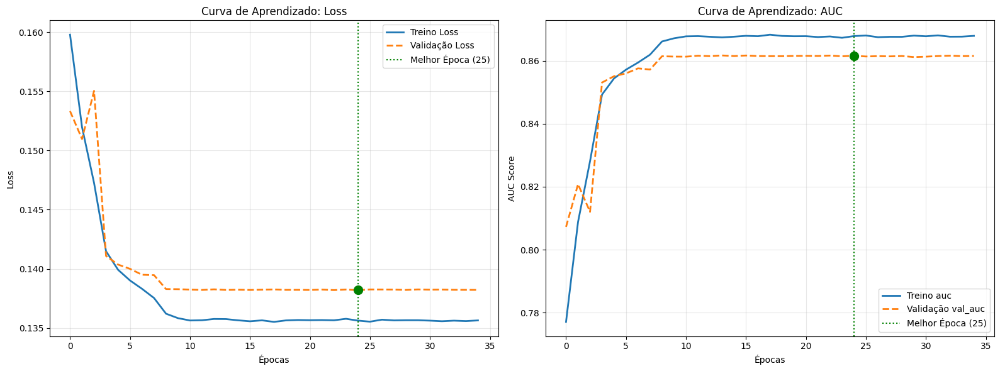

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import os

if os.path.exists(csv_log_file):
    history_df = pd.read_csv(csv_log_file)
    
    cols = history_df.columns.tolist()
    print(f"Colunas encontradas no CSV: {cols}")
    
    auc_col = next((c for c in cols if 'auc' in c and 'val_' not in c), None)
    val_auc_col = next((c for c in cols if 'val_' in c and 'auc' in c), None)
    
    if not auc_col or not val_auc_col:
        print("\nAVISO: Não foi possível encontrar colunas de AUC automaticamente.")
        print("Verifique se 'metrics=['AUC']' ou 'metrics=[tf.keras.metrics.AUC(name='auc')]' foi usado no compile.")
        auc_col = cols[1] if len(cols) > 1 else 'loss'
        val_auc_col = cols[3] if len(cols) > 3 else 'val_loss'
    else:
        print(f"Usando colunas de AUC: Treino='{auc_col}', Validação='{val_auc_col}'")

    best_epoch_idx = history_df['val_loss'].idxmin()
    best_epoch = history_df.iloc[best_epoch_idx]['epoch']
    best_val_loss = history_df.iloc[best_epoch_idx]['val_loss']
    best_val_auc = history_df.iloc[best_epoch_idx][val_auc_col]

    print(f"\nMelhor Época: {int(best_epoch) + 1}")
    print(f"Melhor Val Loss: {best_val_loss:.4f}")
    print(f"Melhor Val AUC: {best_val_auc:.4f}")

    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    
    axes[0].plot(history_df['epoch'], history_df['loss'], label='Treino Loss', linewidth=2)
    axes[0].plot(history_df['epoch'], history_df['val_loss'], label='Validação Loss', linewidth=2, linestyle='--')
    
    axes[0].axvline(best_epoch, color='green', linestyle=':', label=f'Melhor Época ({int(best_epoch)+1})')
    axes[0].scatter(best_epoch, best_val_loss, color='green', s=100, zorder=5)
    
    axes[0].set_title('Curva de Aprendizado: Loss')
    axes[0].set_xlabel('Épocas')
    axes[0].set_ylabel('Loss')
    axes[0].grid(True, alpha=0.3)
    axes[0].legend()

    axes[1].plot(history_df['epoch'], history_df[auc_col], label=f'Treino {auc_col}', linewidth=2)
    axes[1].plot(history_df['epoch'], history_df[val_auc_col], label=f'Validação {val_auc_col}', linewidth=2, linestyle='--')
    
    axes[1].axvline(best_epoch, color='green', linestyle=':', label=f'Melhor Época ({int(best_epoch)+1})')
    axes[1].scatter(best_epoch, best_val_auc, color='green', s=100, zorder=5)
    
    axes[1].set_title(f'Curva de Aprendizado: {auc_col.upper()}')
    axes[1].set_xlabel('Épocas')
    axes[1].set_ylabel('AUC Score')
    axes[1].grid(True, alpha=0.3)
    axes[1].legend(loc='lower right')

    plt.tight_layout()
    plt.show()

else:
    print(f"Arquivo de log não encontrado em: {csv_log_file}")

Gerando previsões no conjunto de teste...


2025-11-30 16:23:09.015269: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Shape dos Rótulos (y_true): (25596, 14)
Shape das Previsões (y_pred): (25596, 14)


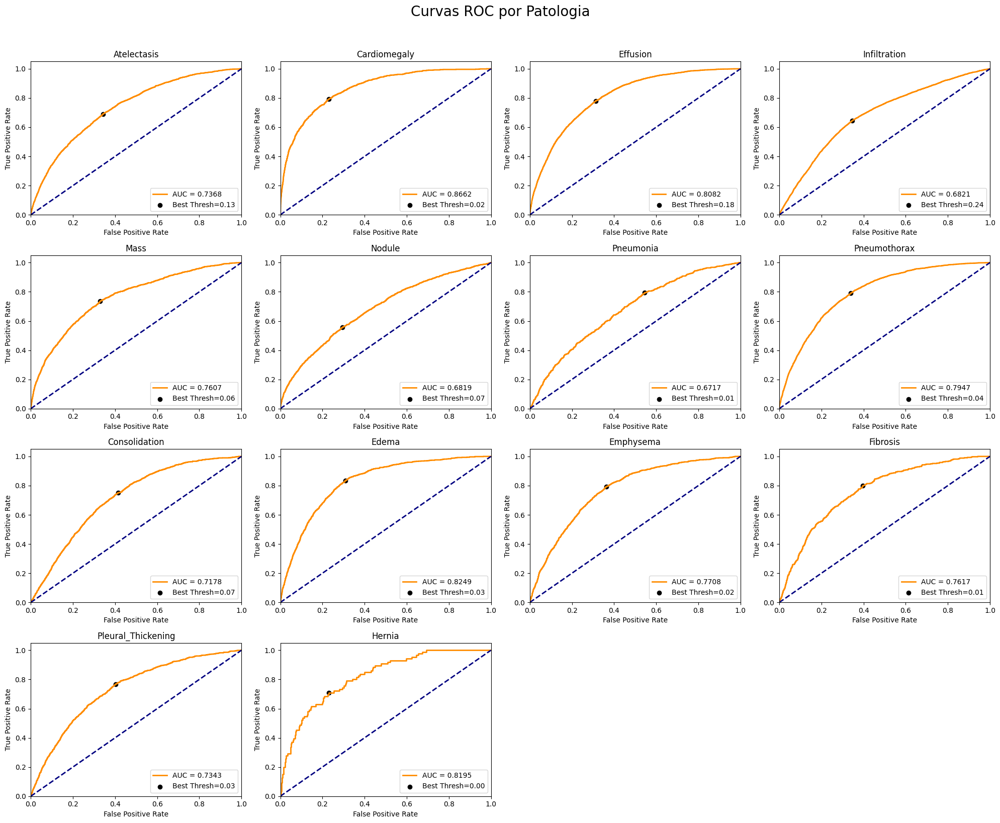


Gerando Matrizes de Confusão (usando o 'Best Threshold' de cada ROC)...


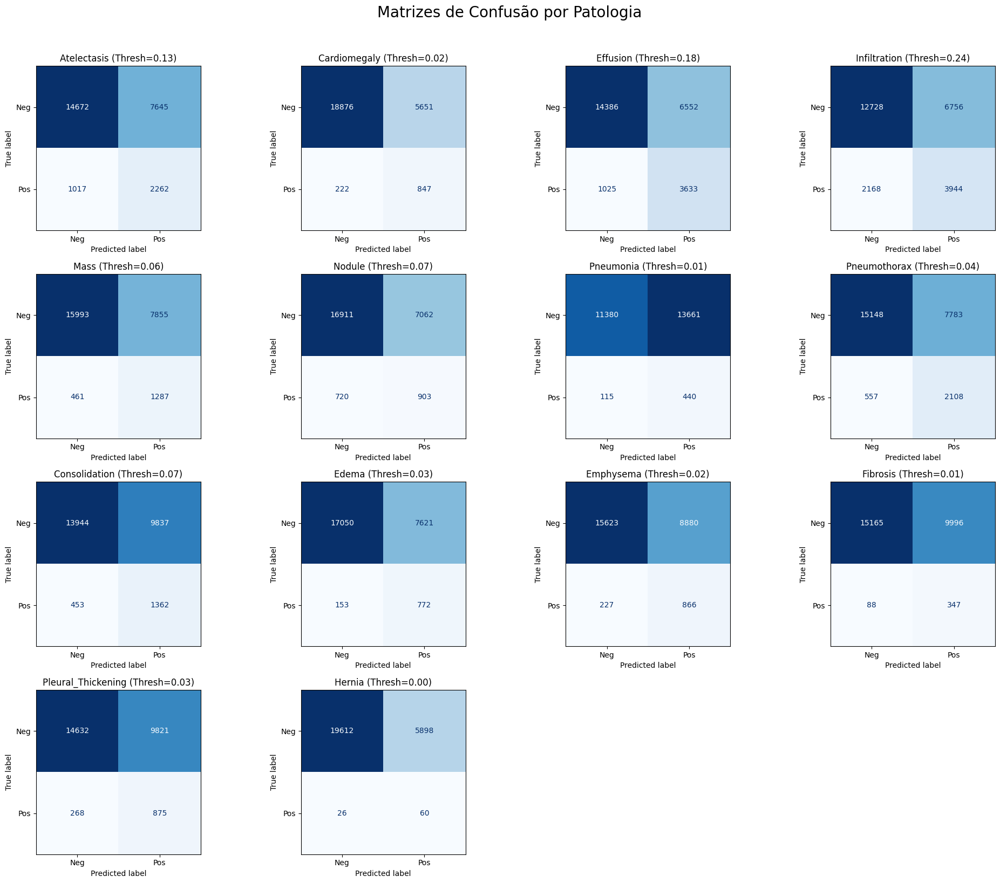

In [ ]:
from sklearn.metrics import roc_curve, auc, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np

test_labels = []
test_predictions = []

for img, label in test_ds:
    test_labels.append(label.numpy())
    test_predictions.append(model.predict(img, verbose=0))

y_true = np.concatenate(test_labels)
y_pred = np.concatenate(test_predictions)

labels_list = ALL_LABELS 


fig_roc, ax_roc = plt.subplots(4, 4, figsize=(20, 16))
fig_roc.suptitle('Curvas ROC por Patologia', fontsize=20, y=1.02)
ax_roc = ax_roc.flatten()

best_thresholds = {}

for i, label_name in enumerate(labels_list):
    fpr, tpr, thresholds = roc_curve(y_true[:, i], y_pred[:, i])
    roc_auc = auc(fpr, tpr)
    
 
    J = tpr - fpr
    ix = np.argmax(J)
    best_thresh = thresholds[ix]
    best_thresholds[label_name] = best_thresh
    
    ax_roc[i].plot(fpr, tpr, color='darkorange', lw=2, label=f'AUC = {roc_auc:.4f}')
    ax_roc[i].plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    ax_roc[i].scatter(fpr[ix], tpr[ix], marker='o', color='black', label=f'Best Thresh={best_thresh:.2f}')
    
    ax_roc[i].set_xlim([0.0, 1.0])
    ax_roc[i].set_ylim([0.0, 1.05])
    ax_roc[i].set_xlabel('False Positive Rate')
    ax_roc[i].set_ylabel('True Positive Rate')
    ax_roc[i].set_title(f'{label_name}')
    ax_roc[i].legend(loc="lower right")

for j in range(len(labels_list), len(ax_roc)):
    fig_roc.delaxes(ax_roc[j])

plt.tight_layout()
plt.show()

fig_cm, ax_cm = plt.subplots(4, 4, figsize=(20, 16))
fig_cm.suptitle('Matrizes de Confusão por Patologia', fontsize=20, y=1.02)
ax_cm = ax_cm.flatten()

for i, label_name in enumerate(labels_list):
    thresh = best_thresholds[label_name]
    y_pred_binary = (y_pred[:, i] > thresh).astype(int)
    
    cm = confusion_matrix(y_true[:, i], y_pred_binary)
    
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Neg', 'Pos'])
    disp.plot(ax=ax_cm[i], cmap='Blues', values_format='d', colorbar=False)
    ax_cm[i].set_title(f'{label_name} (Thresh={thresh:.2f})')

for j in range(len(labels_list), len(ax_cm)):
    fig_cm.delaxes(ax_cm[j])

plt.tight_layout()
plt.show()

# XAI

### Geração dos Bounding Box


In [19]:
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt

%matplotlib inline
from packaging.version import parse as version

from tf_keras_vis.utils import num_of_gpus

if version(tf.version.VERSION) < version('2.16.0'):
    import tensorflow.keras as keras
else:
    import keras
    
_, gpus = num_of_gpus()
print('Tensorflow recognized {} GPUs'.format(gpus))

Tensorflow recognized 1 GPUs


In [20]:
bbox_df = pd.read_csv('BBox_List_2017.csv')

effusion_bbox_df = bbox_df[bbox_df['Finding Label'] == 'Effusion']
mass_bbox_df = bbox_df[bbox_df['Finding Label'] == 'Mass']
pneumothorax_bbox_df = bbox_df[bbox_df['Finding Label'] == 'Pneumothorax']

In [21]:
BBOX_DIR = "./images_with_bboxes"

In [ ]:
import cv2
import os

BBOX_DIR = "./images_with_bboxes"
NO_BBOX_DIR = "./images_without_bboxes"  

os.makedirs(BBOX_DIR, exist_ok=True)
os.makedirs(NO_BBOX_DIR, exist_ok=True)

def draw_bbox(image_path, disease, bbox, color=(255, 0, 0), thickness=2):
    img = cv2.imread(image_path)

    if img is None:
        print(f"Erro ao ler: {image_path}")
        return None


    filename = os.path.basename(image_path)
    save_path_original = os.path.join(NO_BBOX_DIR, filename)
    
    if not os.path.exists(save_path_original):
        cv2.imwrite(save_path_original, img)
 
 
    x, y, w, h = [int(i) for i in bbox] 
    start_point, end_point = (x, y), (x + w, y + h)
    
    cv2.rectangle(img, start_point, end_point, color, thickness)
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale_coords = 0.35
    font_scale_disease = 0.5 
    font_thickness = 1
    
    coords_text = f"{start_point}"
    (coords_w, coords_h), _ = cv2.getTextSize(coords_text, font, font_scale_coords, font_thickness)
    cv2.putText(img, coords_text, (x, y - 5), font, font_scale_coords, color, font_thickness)
    
    disease_x = x + coords_w + 10
    disease_y = y - 5
    cv2.putText(img, disease, (disease_x, disease_y), font, font_scale_disease, color, 2)

    # Coordenada final
    cv2.putText(img, f"{end_point}", (end_point[0], end_point[1] + 10), font, font_scale_coords, color, font_thickness)

    # Salva imagem COM bbox
    name, ext = os.path.splitext(filename)
    new_filename = f"{name}_{disease}_bbox{ext}"
    
    save_path = os.path.join(BBOX_DIR, new_filename)
    cv2.imwrite(save_path, img)

    return img

In [23]:
lista_doencas = ['Effusion', 'Mass', 'Pneumothorax']

bbox_df \
    .sort_values(by='Finding Label') \
    .apply(lambda row: draw_bbox(
        os.path.join(TEST_DIR, row['Image Index']),
        row['Finding Label'].lower(),
        [row['Bbox [x'], row['y'], row['w'], row['h]']]
    ), axis=1)

0      [[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...
115    [[[0, 0, 0], [1, 1, 1], [1, 1, 1], [1, 1, 1], ...
116    [[[119, 119, 119], [115, 115, 115], [116, 116,...
117    [[[1, 1, 1], [1, 1, 1], [1, 1, 1], [1, 1, 1], ...
118    [[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...
                             ...                        
898    [[[90, 90, 90], [83, 83, 83], [80, 80, 80], [7...
897    [[[0, 0, 0], [4, 4, 4], [12, 12, 12], [11, 11,...
896    [[[235, 235, 235], [233, 233, 233], [237, 237,...
909    [[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...
900    [[[0, 0, 0], [17, 17, 17], [22, 22, 22], [21, ...
Length: 984, dtype: object

Procurando imagem (MAX) para: Effusion...


2025-12-02 23:49:13.759739: I external/local_xla/xla/service/service.cc:163] XLA service 0x7cf8b80024a0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2025-12-02 23:49:13.759757: I external/local_xla/xla/service/service.cc:171]   StreamExecutor device (0): NVIDIA GeForce RTX 3050 6GB Laptop GPU, Compute Capability 8.6
2025-12-02 23:49:13.884373: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-12-02 23:49:15.222337: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:473] Loaded cuDNN version 91400
I0000 00:00:1764730176.654911   82415 device_compiler.h:196] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


 > Imagem escolhida (MAX): 00029894_000.png (Confiança: 94.95%)
Procurando imagem (MAX) para: Mass...
 > Imagem escolhida (MAX): 00013911_021.png (Confiança: 85.07%)
Procurando imagem (MAX) para: Pneumothorax...
 > Imagem escolhida (MAX): 00029259_027.png (Confiança: 37.10%)


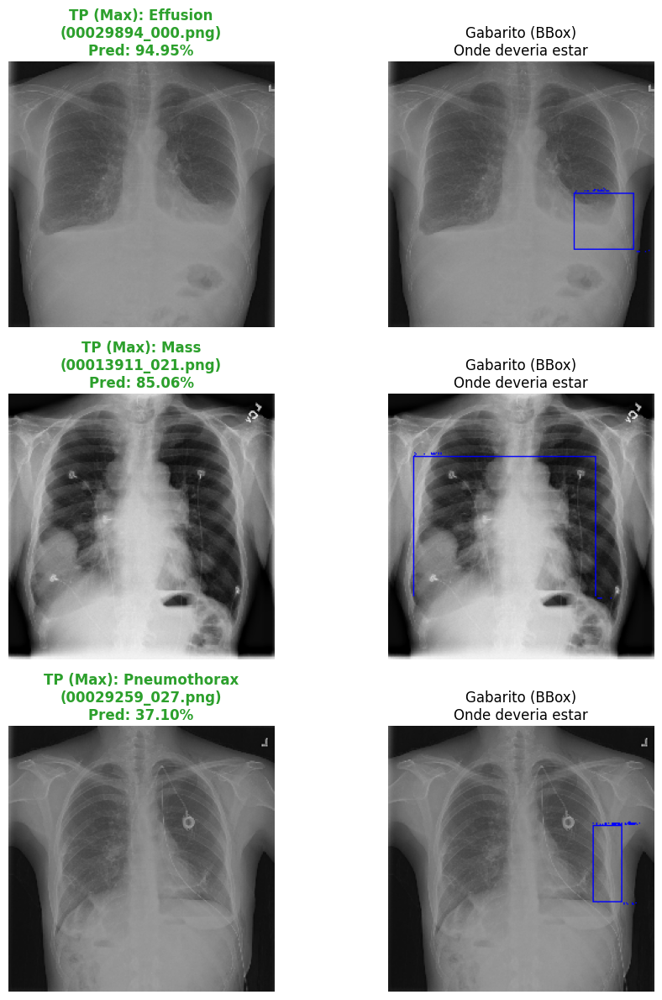

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import keras
import random

SELECTION_MODE = 'MAX'  

def get_row_by_mode(df, label_name, image_dir, mode='MAX'):
    print(f"Procurando imagem ({mode}) para: {label_name}...")

    batch_images = []
    valid_indices = [] 

    for idx, row in df.iterrows():
        try:
            img_path = f"{image_dir}/{row['Image Index']}"
            img = keras.preprocessing.image.load_img(img_path, target_size=(224, 224))
            img_array = keras.preprocessing.image.img_to_array(img)
            batch_images.append(img_array)
            valid_indices.append(idx) 
        except Exception as e:
            continue

    if not batch_images:
        print(f"Erro: Nenhuma imagem encontrada para {label_name}")
        return None

    batch_images = np.array(batch_images)
    batch_images_preprocessed = keras.applications.densenet.preprocess_input(batch_images.copy())

    predictions = model.predict(batch_images_preprocessed, verbose=0)
    label_col_index = ALL_LABELS.index(label_name)

    if mode == 'MAX':
        target_local_index = np.argmax(predictions[:, label_col_index])
    elif mode == 'MIN':
        target_local_index = np.argmin(predictions[:, label_col_index])
    else:
        target_local_index = np.random.randint(0, len(predictions))

    final_score = predictions[target_local_index, label_col_index]

    final_df_index = valid_indices[target_local_index]
    selected_row = df.loc[final_df_index]

    print(f" > Imagem escolhida ({mode}): {selected_row['Image Index']} (Confiança: {final_score:.2%})")
    return selected_row

image_titles = ['Effusion', 'Mass', 'Pneumothorax']

row_effusion = get_row_by_mode(effusion_bbox_df, 'Effusion', TEST_DIR, mode=SELECTION_MODE)
row_mass = get_row_by_mode(mass_bbox_df, 'Mass', TEST_DIR, mode=SELECTION_MODE)
row_pneumo = get_row_by_mode(pneumothorax_bbox_df, 'Pneumothorax', TEST_DIR, mode=SELECTION_MODE)

effusion_base = os.path.splitext(row_effusion['Image Index'])[0]
mass_base = os.path.splitext(row_mass['Image Index'])[0]
pneumo_base = os.path.splitext(row_pneumo['Image Index'])[0]

effusion_img = keras.preprocessing.image.load_img(f'{TEST_DIR}/{row_effusion["Image Index"]}', target_size=(224, 224))
mass_img = keras.preprocessing.image.load_img(f'{TEST_DIR}/{row_mass["Image Index"]}', target_size=(224, 224))
pneumothorax_img = keras.preprocessing.image.load_img(f'{TEST_DIR}/{row_pneumo["Image Index"]}', target_size=(224, 224))

try:
    effusion_img_bbox = keras.preprocessing.image.load_img(f'{BBOX_DIR}/{effusion_base}_effusion_bbox.png', target_size=(224, 224))
    mass_img_bbox = keras.preprocessing.image.load_img(f'{BBOX_DIR}/{mass_base}_mass_bbox.png', target_size=(224, 224))
    pneumothorax_img_bbox = keras.preprocessing.image.load_img(f'{BBOX_DIR}/{pneumo_base}_pneumothorax_bbox.png', target_size=(224, 224))
except FileNotFoundError:
    print("\nAVISO: BBox visual não encontrada. Usando original.")
    effusion_img_bbox = effusion_img
    mass_img_bbox = mass_img
    pneumothorax_img_bbox = pneumothorax_img

images = np.asarray([np.array(effusion_img), np.array(mass_img), np.array(pneumothorax_img)])
images_bbox = [effusion_img_bbox, mass_img_bbox, pneumothorax_img_bbox]

selected_image_indices = [
    row_effusion['Image Index'],
    row_mass['Image Index'],
    row_pneumo['Image Index']
]

X_to_predict = keras.applications.densenet.preprocess_input(np.array(images, dtype=float))
predictions = model.predict(X_to_predict, verbose=0)

f, ax = plt.subplots(nrows=3, ncols=2, figsize=(10, 12))

if SELECTION_MODE == 'MAX':
    title_color = '#2ca02c'
    prefix_type = "TP (Max)"    
elif SELECTION_MODE == 'MIN':
    title_color = '#d62728' 
    prefix_type = "FN (Min)"    
else:
    title_color = '#1f77b4' 
    prefix_type = "Random"

for i, title in enumerate(image_titles):
    label_index = ALL_LABELS.index(title)
    score = predictions[i][label_index]

    ax[i, 0].set_title(f"{prefix_type}: {title}\n({selected_image_indices[i]})\nPred: {score:.2%}", 
                       fontsize=12, fontweight='bold', color=title_color)
    ax[i, 0].imshow(images[i])
    ax[i, 0].axis('off')

    ax[i, 1].set_title(f"Gabarito (BBox)\nOnde deveria estar", fontsize=12)
    ax[i, 1].imshow(images_bbox[i])
    ax[i, 1].axis('off')

plt.tight_layout()
plt.show()

Calculando predições...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
Gerando heatmaps para Grad-CAM...
Gerando heatmaps para Grad-CAM++...
Gerando heatmaps para Score-CAM...
96/96 ━━━━━━━━━━━━━━━━━━━━ 16s 94ms/step
Gerando heatmaps para Layer-CAM...


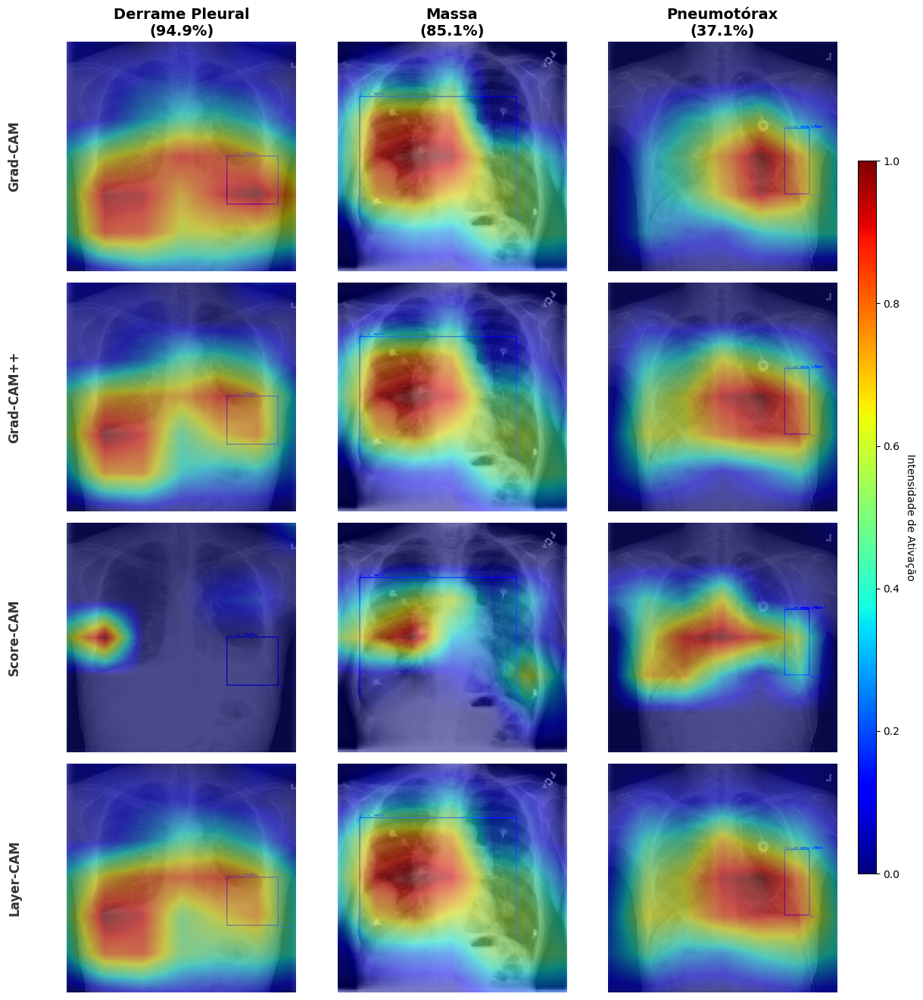

In [ ]:
image_titles = ['Effusion', 'Mass', 'Pneumothorax']

image_titles_pt = ['Derrame Pleural', 'Massa', 'Pneumotórax']

X = keras.applications.densenet.preprocess_input(images)

from tf_keras_vis.utils.model_modifiers import ReplaceToLinear

replace2linear = ReplaceToLinear()

from tf_keras_vis.utils.scores import CategoricalScore

score = CategoricalScore([ALL_LABELS.index('Effusion'), ALL_LABELS.index('Mass'), ALL_LABELS.index('Pneumothorax')])

import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import os
import keras

from tf_keras_vis.gradcam import Gradcam
from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.scorecam import Scorecam
from tf_keras_vis.layercam import Layercam

print("Calculando predições...")
predictions = model.predict(X)

effusion_base = os.path.splitext(row_effusion['Image Index'])[0]
mass_base = os.path.splitext(row_mass['Image Index'])[0]
pneumo_base = os.path.splitext(row_pneumo['Image Index'])[0]

display_images = []

try:
    display_images.append(keras.preprocessing.image.load_img(f'{BBOX_DIR}/{effusion_base}_effusion_bbox.png', target_size=(224,224)))
    display_images.append(keras.preprocessing.image.load_img(f'{BBOX_DIR}/{mass_base}_mass_bbox.png', target_size=(224,224)))
    display_images.append(keras.preprocessing.image.load_img(f'{BBOX_DIR}/{pneumo_base}_pneumothorax_bbox.png', target_size=(224,224)))
except Exception as e:
    print(f"Erro ao carregar imagens BBox: {e}")

gradcam_obj = Gradcam(model, model_modifier=replace2linear, clone=True)
gradcam_plus_plus_obj = GradcamPlusPlus(model, model_modifier=replace2linear, clone=True)
scorecam_obj = Scorecam(model)
layercam_obj = Layercam(model, model_modifier=replace2linear)

heatmap_methods_list = [
    {"name": "Grad-CAM", "generator": gradcam_obj, "kwargs": {"penultimate_layer": 'bn', "seek_penultimate_conv_layer": False}, "overlay": True},
    {"name": "Grad-CAM++", "generator": gradcam_plus_plus_obj, "kwargs": {"penultimate_layer": 'bn', "seek_penultimate_conv_layer": False}, "overlay": True},
    {"name": "Score-CAM", "generator": scorecam_obj, "kwargs": {"penultimate_layer": 'bn',"seek_penultimate_conv_layer": False}, "overlay": True},
    {"name": "Layer-CAM", "generator": layercam_obj, "kwargs": {"penultimate_layer": 'bn',"seek_penultimate_conv_layer": False}, "overlay": True}
]

num_methods = len(heatmap_methods_list)
num_images = len(image_titles)

fig, axes = plt.subplots(nrows=num_methods, ncols=num_images, figsize=(15, num_methods * 3.5))

if num_methods == 1 and num_images == 1:
    axes = np.array([[axes]])
elif num_methods == 1:
    axes = np.expand_dims(axes, axis=0)
elif num_images == 1:
    axes = np.expand_dims(axes, axis=1)

scalar_mappable = None
all_generated_heatmaps = {}

for i, method_info in enumerate(heatmap_methods_list):
    method_name = method_info["name"]
    generator = method_info["generator"]
    kwargs = method_info["kwargs"]
    overlay = method_info["overlay"]

    print(f"Gerando heatmaps para {method_name}...")

    try:
        cam_maps = generator(score, X, **kwargs)
        all_generated_heatmaps[method_name] = cam_maps

        if i == 0 and scalar_mappable is None:
            norm = plt.Normalize(vmin=0, vmax=1)
            scalar_mappable = plt.cm.ScalarMappable(cmap='jet', norm=norm)
            scalar_mappable.set_array([])

        for j in range(num_images):
            ax = axes[i, j]

            target_class_name = image_titles[j]
            target_index = ALL_LABELS.index(target_class_name)
            confidence_score = predictions[j][target_index]

            if i == 0:
                title_text = f"{image_titles_pt[j]}\n({confidence_score:.1%})"
                ax.set_title(title_text, fontsize=14, fontweight='bold')

            if j == 0:
                ax.text(-0.2, 0.5, method_name,
                        transform=ax.transAxes,
                        rotation=90,
                        va='center', ha='right',
                        fontsize=12, fontweight='bold', color='#333333')

            if overlay:
                heatmap = np.uint8(cm.jet(cam_maps[j])[..., :3] * 255)
                ax.imshow(display_images[j]) 
                ax.imshow(heatmap, cmap='jet', alpha=0.5)
            else:
                ax.imshow(cam_maps[j], cmap='jet')

            ax.axis('off')

    except Exception as e:
        print(f"Erro ao gerar {method_name}: {e}")
        continue

plt.tight_layout(rect=[0.05, 0.03, 1, 0.98])

if scalar_mappable is not None:
    cbar = fig.colorbar(scalar_mappable, ax=axes.ravel().tolist(), 
                        orientation='vertical', shrink=0.75, pad=0.02, aspect=40)
    cbar.set_label('Intensidade de Ativação', rotation=270, labelpad=15)

plt.show()

In [ ]:
import numpy as np

def uniform_perturbation(image, x_center, y_center, radius):
    """
    Applies uniform random perturbation (grayscale noise) to a square region.
    Optimized for X-Ray images.
    """
    perturbed_image = image.copy()

    if image.ndim == 2:
        h, w = image.shape
        c = 1
    else:
        h, w, c = image.shape

    x_min = max(0, x_center - radius)
    x_max = min(w, x_center + radius + 1)
    y_min = max(0, y_center - radius)
    y_max = min(h, y_center + radius + 1)

    patch_height = y_max - y_min
    patch_width = x_max - x_min


    noise_patch_1ch = np.random.randint(0, 256, size=(patch_height, patch_width), dtype=image.dtype)


    if c == 3:
        noise_patch = np.stack([noise_patch_1ch]*3, axis=-1)
    else:
        if image.ndim == 3:
            noise_patch = np.expand_dims(noise_patch_1ch, axis=-1)
        else:
            noise_patch = noise_patch_1ch

 
    perturbed_image[y_min:y_max, x_min:x_max] = noise_patch

    return perturbed_image

print("Função 'uniform_perturbation' otimizada para Raio-X definida.")

Função 'uniform_perturbation' otimizada para Raio-X definida.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step

--- Gerando AOPC para: Derrame Pleural ---


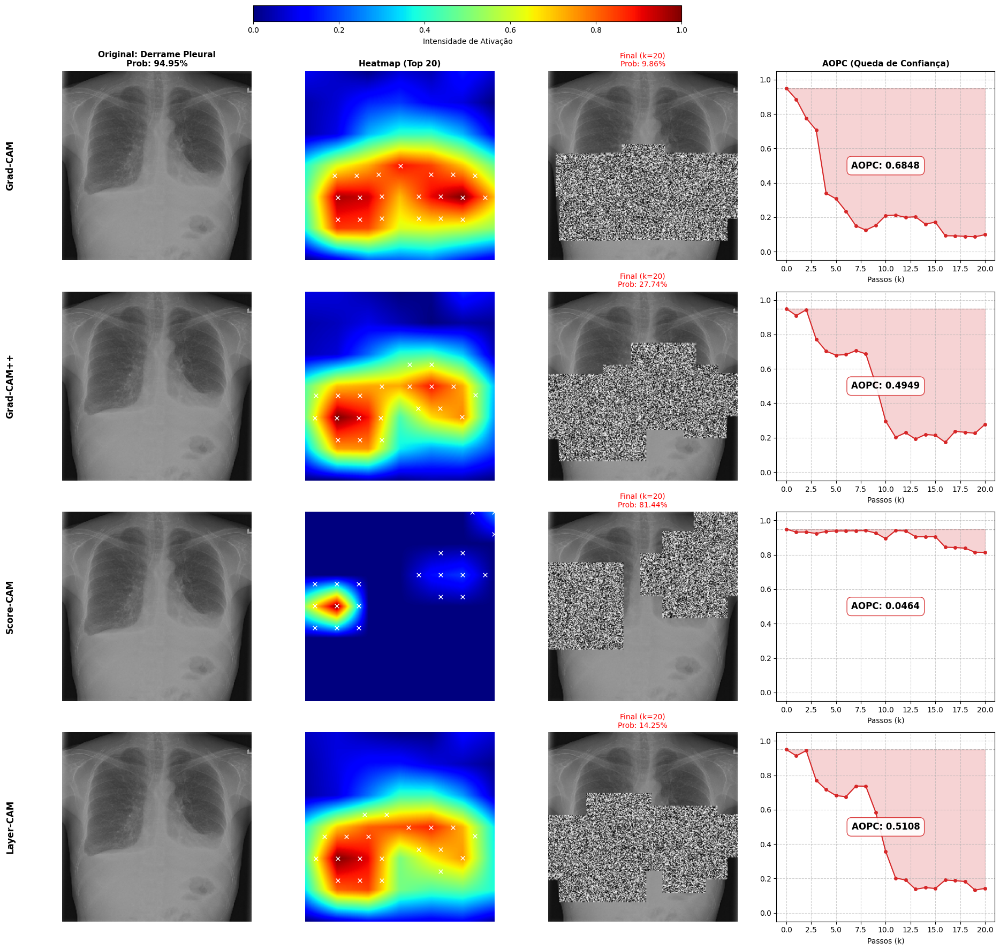


--- Gerando AOPC para: Massa Pulmonar ---


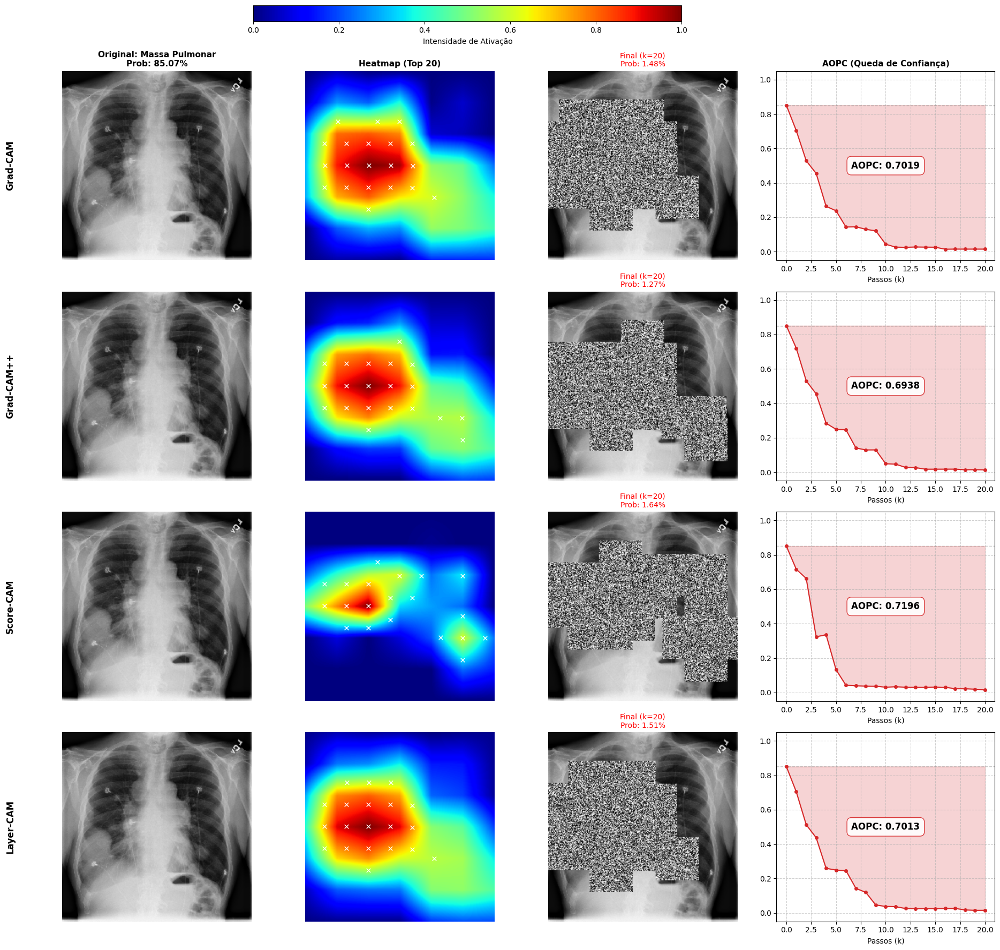


--- Gerando AOPC para: Pneumotórax ---


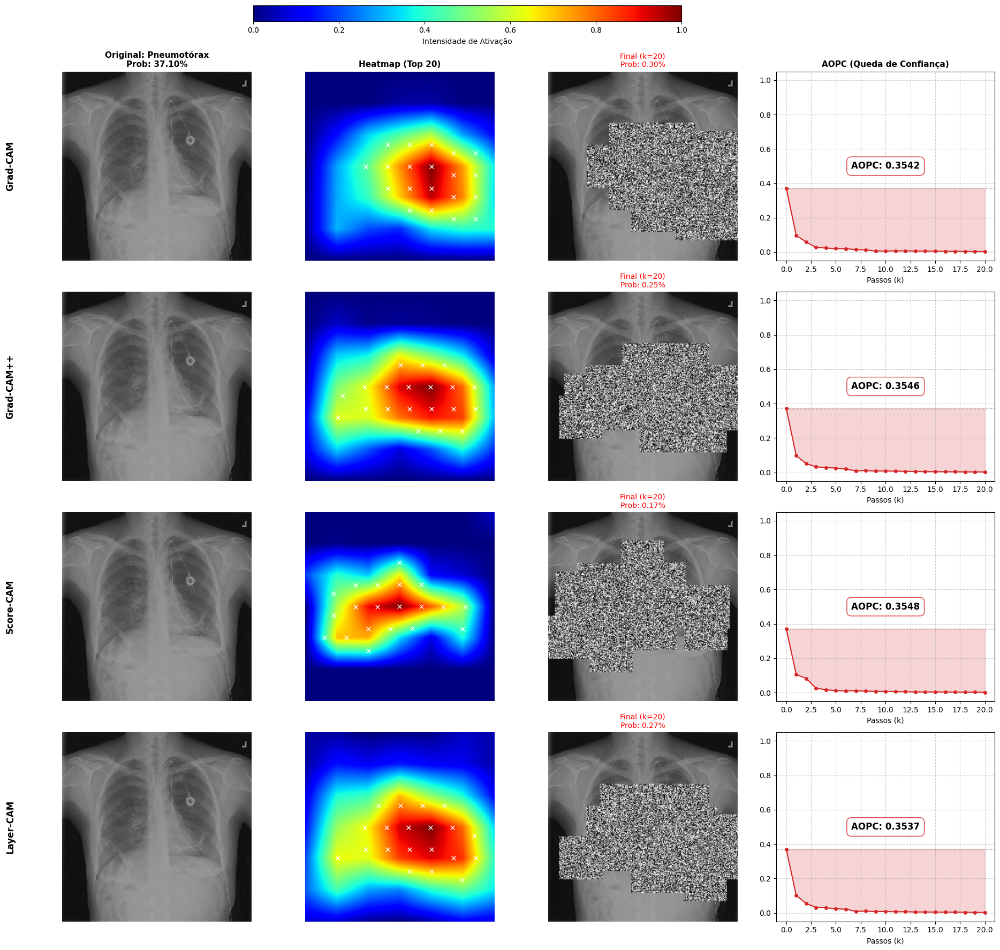

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import keras

perturbation_radius = 25
top_k = 20

traducao = {
    'Effusion': 'Derrame Pleural',
    'Mass': 'Massa Pulmonar',
    'Pneumothorax': 'Pneumotórax',
    'Atelectasis': 'Atelectasia',
    'Infiltration': 'Infiltração',
    'Nodule': 'Nódulo'
}

initial_predictions = model.predict(X)
initial_confidences = score(initial_predictions)

norm = plt.Normalize(vmin=0, vmax=1)
sm = cm.ScalarMappable(cmap='jet', norm=norm)
sm.set_array([])

num_images = len(image_titles)
method_names = list(all_generated_heatmaps.keys())

for j in range(num_images):
    title_en = image_titles[j]
    title_pt = traducao.get(title_en, title_en)
    
    current_idx_str = selected_image_indices[j]
    original_img_rgb = images[j]
    init_conf_val = initial_confidences[j]

    print(f"\n--- Gerando AOPC para: {title_pt} ---")

    # Layout
    num_methods = len(method_names)
    fig, axes = plt.subplots(nrows=num_methods, ncols=4, figsize=(20, num_methods * 5))

    if num_methods == 1: axes = np.expand_dims(axes, axis=0)

    for i, (method_name, heatmaps) in enumerate(all_generated_heatmaps.items()):
        heatmap_data = heatmaps[j]
        heatmap_working_copy = heatmap_data.copy()
        current_perturbed_img = original_img_rgb.copy()
        removed_coords = []
        step_scores = [init_conf_val]
        steps_x = [0]

        for k in range(1, top_k + 1):
            max_coords = np.unravel_index(np.argmax(heatmap_working_copy), heatmap_working_copy.shape)
            y_center, x_center = max_coords
            removed_coords.append((x_center, y_center))
            current_perturbed_img = uniform_perturbation(current_perturbed_img, x_center, y_center, perturbation_radius)
            y_min, y_max = max(0, y_center - perturbation_radius), min(heatmap_working_copy.shape[0], y_center + perturbation_radius + 1)
            x_min, x_max = max(0, x_center - perturbation_radius), min(heatmap_working_copy.shape[1], x_center + perturbation_radius + 1)
            heatmap_working_copy[y_min:y_max, x_min:x_max] = -np.inf
            
            img_preproc = keras.applications.densenet.preprocess_input(np.expand_dims(current_perturbed_img, axis=0))
            pred_k = model.predict(img_preproc, verbose=0)
            target_class_idx = ALL_LABELS.index(title_en)
            step_scores.append(pred_k[0, target_class_idx])
            steps_x.append(k)

        drops = [init_conf_val - val for val in step_scores[1:]]
        aopc_score = np.mean(drops)

      
        ax_orig = axes[i, 0]
        if i == 0: 
            ax_orig.set_title(f"Original: {title_pt}\nProb: {init_conf_val:.2%}", fontsize=11, fontweight='bold')
        
        ax_orig.text(-0.25, 0.5, method_name, transform=ax_orig.transAxes,
                     rotation=90, va='center', ha='right', fontsize=12, fontweight='bold')
        ax_orig.imshow(original_img_rgb)
        ax_orig.axis('off')

        ax_heatmap = axes[i, 1]
        if i == 0: ax_heatmap.set_title(f"Heatmap (Top {top_k})", fontsize=11, fontweight='bold')
        ax_heatmap.imshow(heatmap_data, cmap='jet', vmin=0, vmax=1)
        for (rx, ry) in removed_coords:
            ax_heatmap.scatter(rx, ry, s=30, c='white', marker='x', linewidths=1)
        ax_heatmap.axis('off')

        ax_pert = axes[i, 2]
        final_conf = step_scores[-1]
        ax_pert.set_title(f"Final (k={top_k})\nProb: {final_conf:.2%}", fontsize=10,
                          color='red' if final_conf < init_conf_val else 'black')
        ax_pert.imshow(current_perturbed_img)
        ax_pert.axis('off')

        ax_curve = axes[i, 3]
        if i == 0: ax_curve.set_title("AOPC (Queda de Confiança)", fontsize=11, fontweight='bold')
        ax_curve.axhline(y=init_conf_val, color='gray', linestyle='--', alpha=0.5, linewidth=1)
        ax_curve.plot(steps_x, step_scores, marker='o', linestyle='-', color='#d62728', markersize=4)
        ax_curve.fill_between(steps_x, step_scores, y2=init_conf_val, alpha=0.2, color='#d62728')
        ax_curve.set_xlabel("Passos (k)")
        ax_curve.set_ylim(-0.05, 1.05)
        ax_curve.grid(True, linestyle='--', alpha=0.6)
        
        text_str = f"AOPC: {aopc_score:.4f}"
        ax_curve.text(top_k/2, 0.5, text_str, ha='center', va='center', fontsize=12, fontweight='bold',
                      bbox=dict(facecolor='white', alpha=0.9, edgecolor='#d62728', boxstyle='round,pad=0.5'))

    
    plt.tight_layout(rect=[0.05, 0.03, 1, 0.88]) 
    

    cbar_ax = fig.add_axes([0.30, 0.90, 0.40, 0.015]) 
    
    cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Intensidade de Ativação', fontsize=10, labelpad=5)
    
    plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step

--- Gerando Deletion para: Derrame Pleural ---


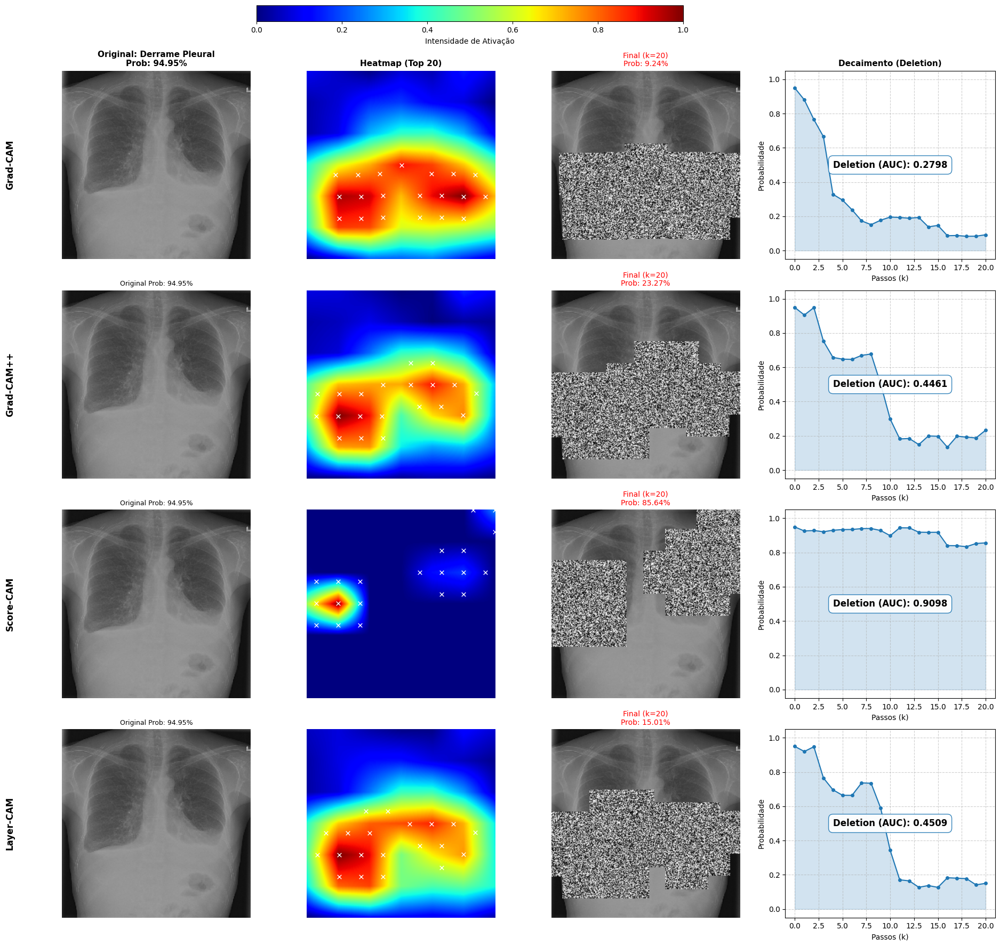


--- Gerando Deletion para: Massa Pulmonar ---


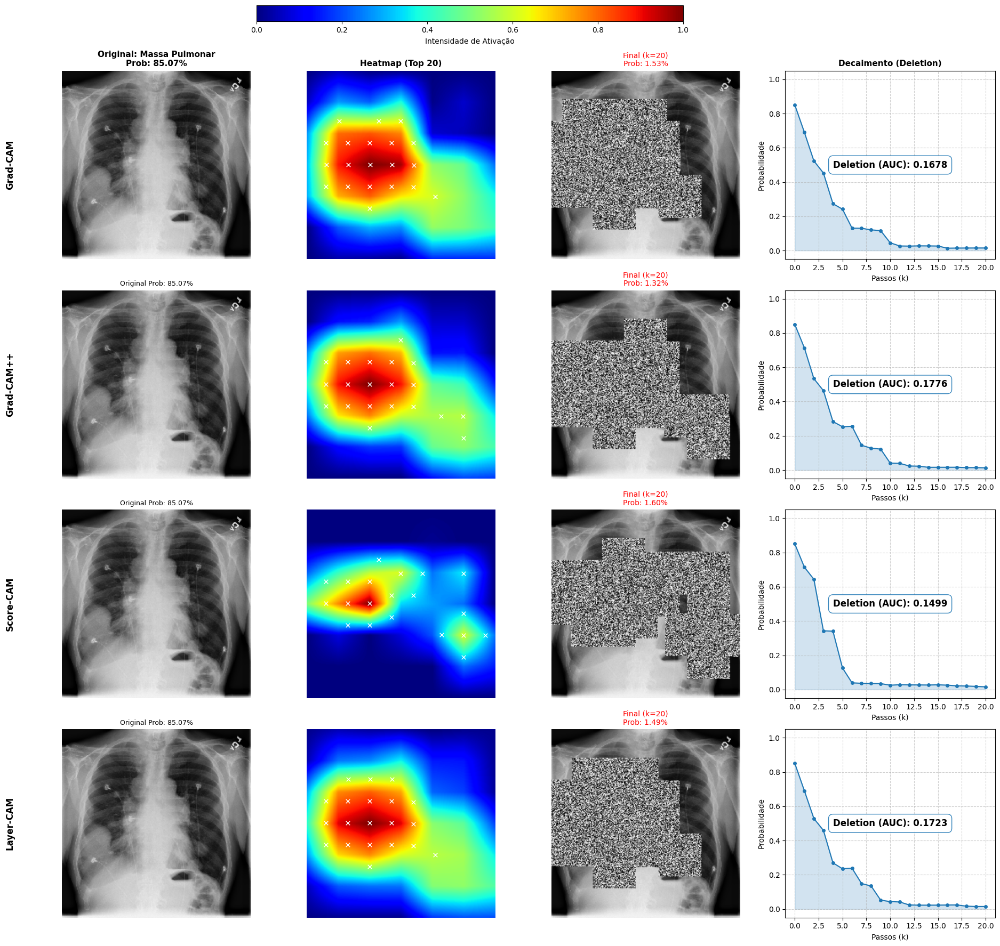


--- Gerando Deletion para: Pneumotórax ---


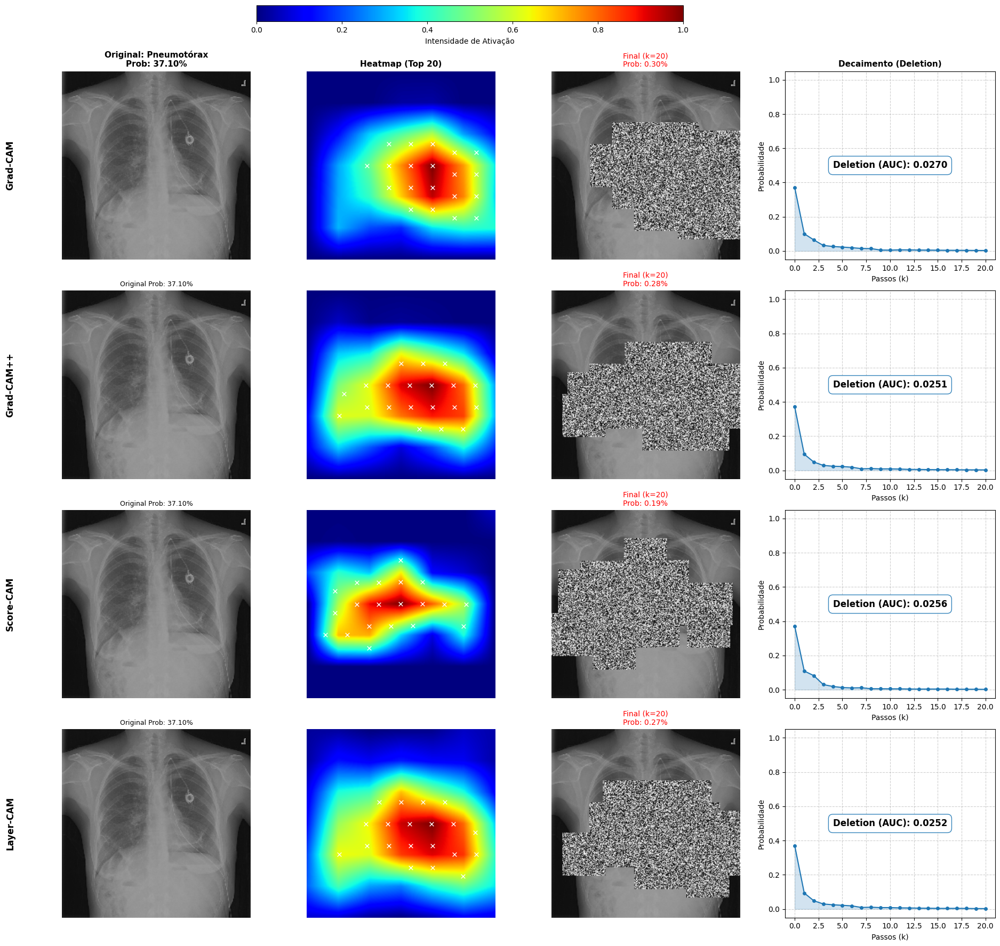


Análise concluída.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import keras

perturbation_radius = 25
top_k = 20

traducao = {
    'Effusion': 'Derrame Pleural',
    'Mass': 'Massa Pulmonar',
    'Pneumothorax': 'Pneumotórax',
    'Atelectasis': 'Atelectasia',
    'Infiltration': 'Infiltração',
    'Nodule': 'Nódulo'
}

initial_predictions = model.predict(X)
initial_confidences = score(initial_predictions)

norm = plt.Normalize(vmin=0, vmax=1)
sm = cm.ScalarMappable(cmap='jet', norm=norm)
sm.set_array([])

num_images = len(image_titles)
method_names = list(all_generated_heatmaps.keys())

for j in range(num_images):
    title_en = image_titles[j]
    title_pt = traducao.get(title_en, title_en)
    
    current_idx_str = selected_image_indices[j]
    original_img_rgb = images[j]
    init_conf_val = initial_confidences[j]

    print(f"\n--- Gerando Deletion para: {title_pt} ---")

    num_methods = len(method_names)
    fig, axes = plt.subplots(nrows=num_methods, ncols=4, figsize=(20, num_methods * 5))

    if num_methods == 1: axes = np.expand_dims(axes, axis=0)

    for i, (method_name, heatmaps) in enumerate(all_generated_heatmaps.items()):
        
        heatmap_data = heatmaps[j]
        heatmap_working_copy = heatmap_data.copy()
        current_perturbed_img = original_img_rgb.copy()
        removed_coords = []
        step_scores = [init_conf_val]
        steps_x = [0]

        for k in range(1, top_k + 1):
            max_coords = np.unravel_index(np.argmax(heatmap_working_copy), heatmap_working_copy.shape)
            y_center, x_center = max_coords
            removed_coords.append((x_center, y_center))

            current_perturbed_img = uniform_perturbation(current_perturbed_img, x_center, y_center, perturbation_radius)
            
            y_min, y_max = max(0, y_center - perturbation_radius), min(heatmap_working_copy.shape[0], y_center + perturbation_radius + 1)
            x_min, x_max = max(0, x_center - perturbation_radius), min(heatmap_working_copy.shape[1], x_center + perturbation_radius + 1)
            heatmap_working_copy[y_min:y_max, x_min:x_max] = -np.inf

            img_preproc = keras.applications.densenet.preprocess_input(np.expand_dims(current_perturbed_img, axis=0))
            pred_k = model.predict(img_preproc, verbose=0)
            target_class_idx = ALL_LABELS.index(title_en)
            step_scores.append(pred_k[0, target_class_idx])
            steps_x.append(k)

        deletion_score = np.trapezoid(step_scores, steps_x) / top_k


        ax_orig = axes[i, 0]
        if i == 0: 
            ax_orig.set_title(f"Original: {title_pt}\nProb: {init_conf_val:.2%}", fontsize=11, fontweight='bold')
        else:
            ax_orig.set_title(f"Original Prob: {init_conf_val:.2%}", fontsize=9)

        ax_orig.text(-0.25, 0.5, method_name, transform=ax_orig.transAxes,
                     rotation=90, va='center', ha='right', fontsize=12, fontweight='bold')
        ax_orig.imshow(original_img_rgb)
        ax_orig.axis('off')

        ax_heatmap = axes[i, 1]
        if i == 0: ax_heatmap.set_title(f"Heatmap (Top {top_k})", fontsize=11, fontweight='bold')
        ax_heatmap.imshow(heatmap_data, cmap='jet', vmin=0, vmax=1)
        for (rx, ry) in removed_coords:
            ax_heatmap.scatter(rx, ry, s=30, c='white', marker='x', linewidths=1)
        ax_heatmap.axis('off')

        ax_pert = axes[i, 2]
        final_conf = step_scores[-1]
        ax_pert.set_title(f"Final (k={top_k})\nProb: {final_conf:.2%}", fontsize=10,
                          color='red' if final_conf < init_conf_val else 'black')
        ax_pert.imshow(current_perturbed_img)
        ax_pert.axis('off')

        ax_curve = axes[i, 3]
        if i == 0: ax_curve.set_title("Decaimento (Deletion)", fontsize=11, fontweight='bold')
        
        ax_curve.plot(steps_x, step_scores, marker='o', linestyle='-', color='#1f77b4', markersize=4)
        ax_curve.fill_between(steps_x, step_scores, alpha=0.2, color='#1f77b4')

        ax_curve.set_xlabel("Passos (k)")
        ax_curve.set_ylabel("Probabilidade")
        ax_curve.set_ylim(-0.05, 1.05)
        ax_curve.grid(True, linestyle='--', alpha=0.6)

        text_str = f"Deletion (AUC): {deletion_score:.4f}"
        ax_curve.text(top_k/2, 0.5, text_str,
                      ha='center', va='center', fontsize=12, fontweight='bold',
                      bbox=dict(facecolor='white', alpha=0.9, edgecolor='#1f77b4', boxstyle='round,pad=0.5'))

    plt.tight_layout(rect=[0.05, 0.03, 1, 0.88]) 
    
    cbar_ax = fig.add_axes([0.30, 0.90, 0.40, 0.015]) 
    
    cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Intensidade de Ativação', fontsize=10, labelpad=5)

    plt.show()

print("\nAnálise concluída.")


--- Gerando Insertion para: Derrame Pleural ---


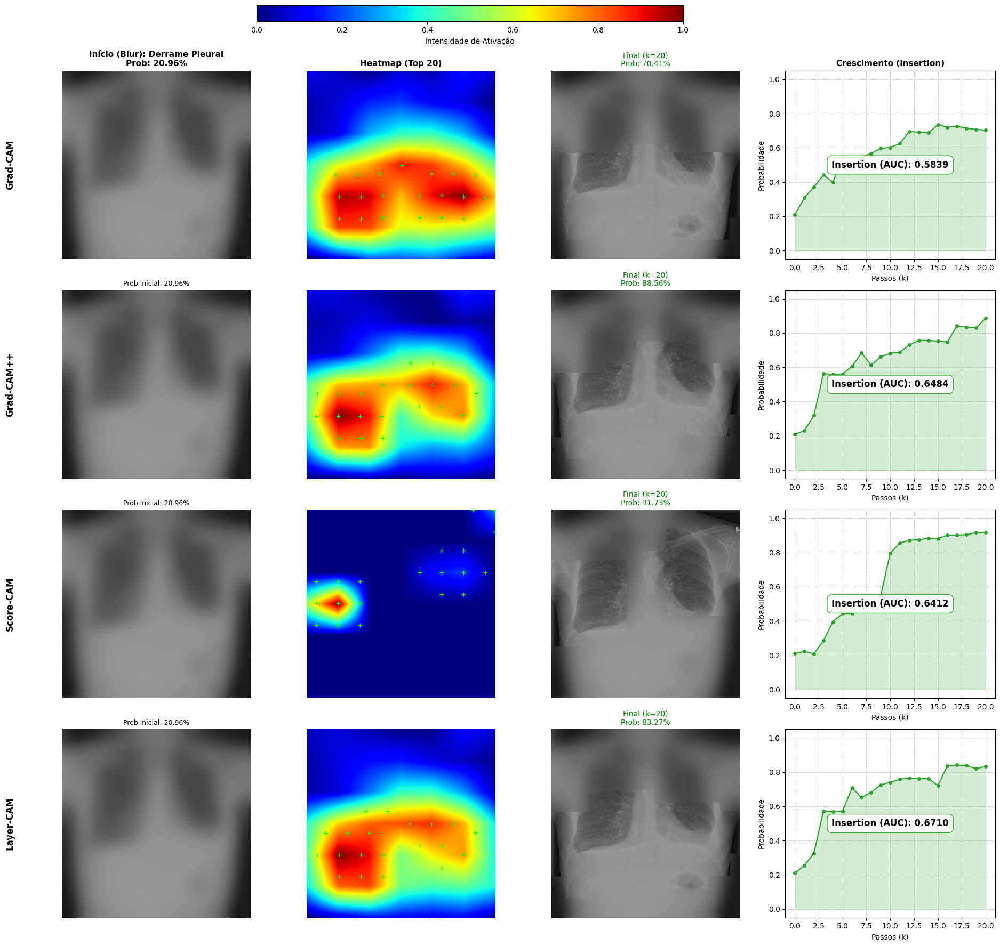


--- Gerando Insertion para: Massa Pulmonar ---


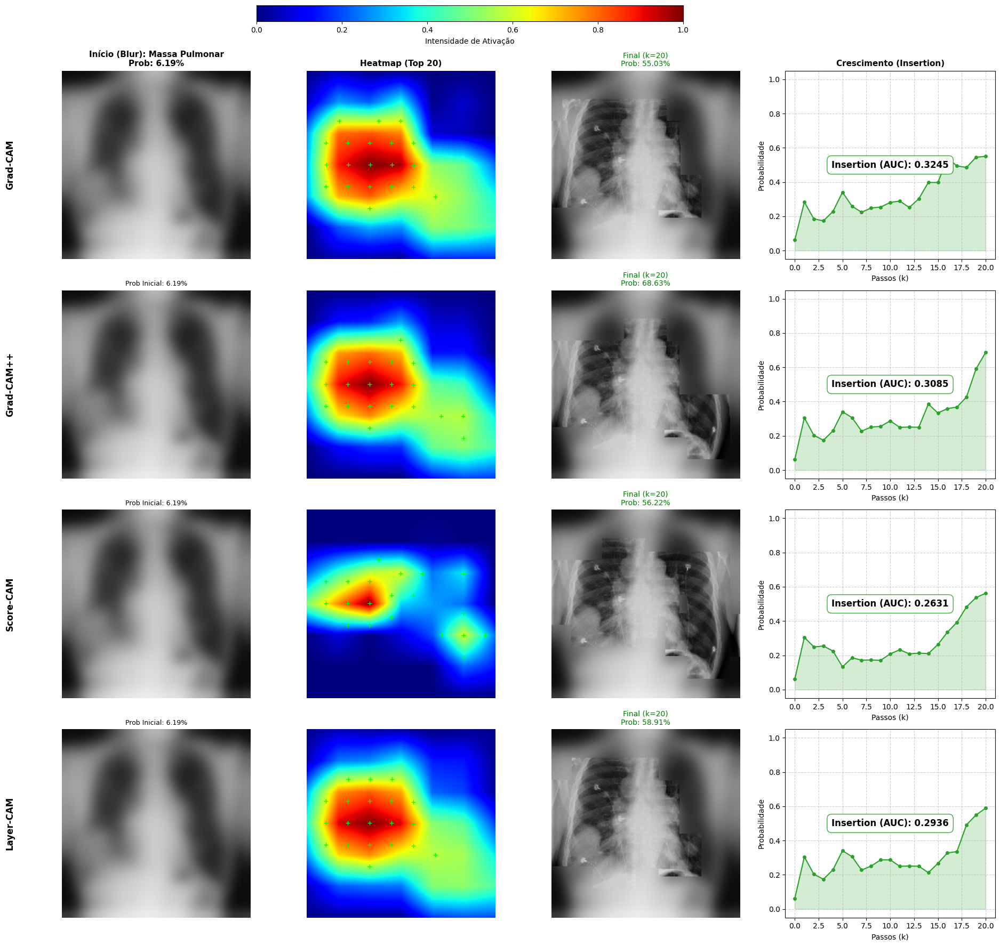


--- Gerando Insertion para: Pneumotórax ---


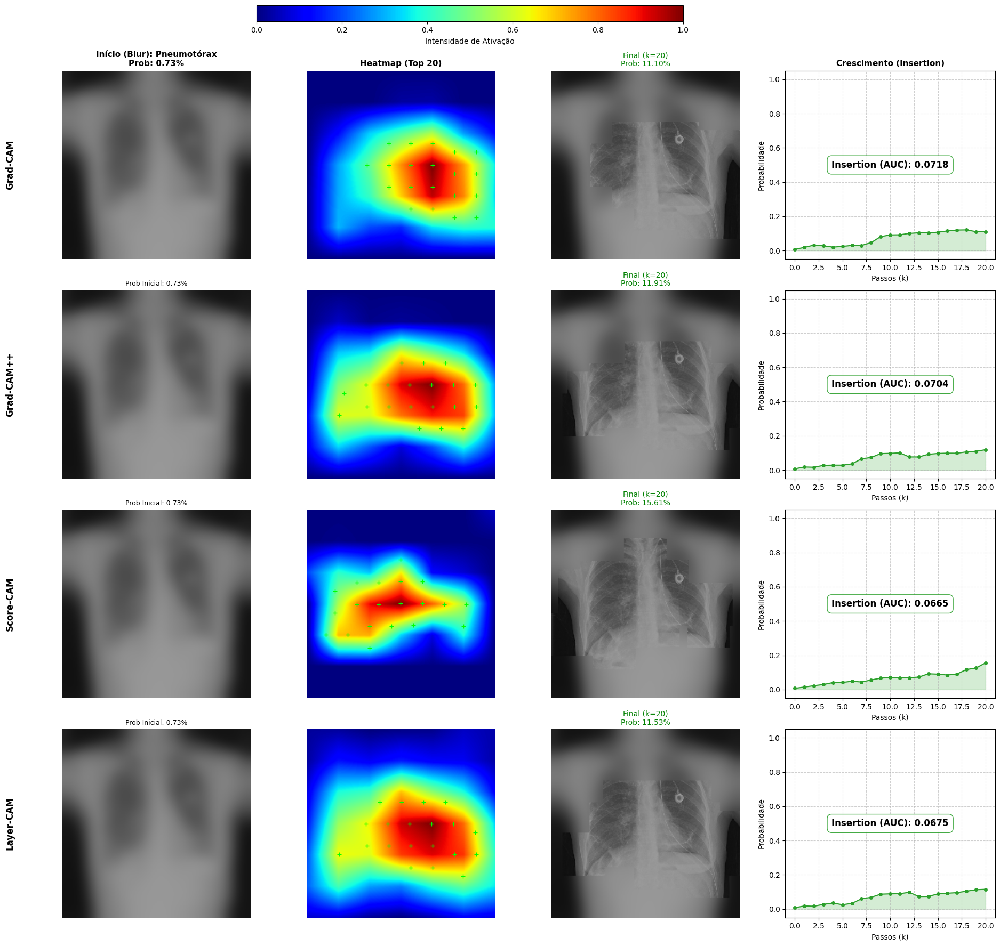


Análise concluída.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import keras
import cv2

perturbation_radius = 25
top_k = 20
blur_kernel_size = (51, 51)

traducao = {
    'Effusion': 'Derrame Pleural',
    'Mass': 'Massa Pulmonar',
    'Pneumothorax': 'Pneumotórax',
    'Atelectasis': 'Atelectasia',
    'Infiltration': 'Infiltração',
    'Nodule': 'Nódulo'
}

norm = plt.Normalize(vmin=0, vmax=1)
sm = cm.ScalarMappable(cmap='jet', norm=norm)
sm.set_array([])

num_images = len(image_titles)
method_names = list(all_generated_heatmaps.keys())

for j in range(num_images):
    title_en = image_titles[j]
    title_pt = traducao.get(title_en, title_en)
    
    current_idx_str = selected_image_indices[j]
    original_img_rgb = images[j]

    blurred_img = cv2.GaussianBlur(original_img_rgb, blur_kernel_size, 0)


    img_preproc_0 = keras.applications.densenet.preprocess_input(np.expand_dims(blurred_img, axis=0))
    pred_0 = model.predict(img_preproc_0, verbose=0)
    target_idx = ALL_LABELS.index(title_en)
    init_conf_val = pred_0[0, target_idx]

    print(f"\n--- Gerando Insertion para: {title_pt} ---")

    num_methods = len(method_names)
    fig, axes = plt.subplots(nrows=num_methods, ncols=4, figsize=(20, num_methods * 5))

    if num_methods == 1: axes = np.expand_dims(axes, axis=0)

    for i, (method_name, heatmaps) in enumerate(all_generated_heatmaps.items()):

        heatmap_data = heatmaps[j]
        heatmap_working_copy = heatmap_data.copy()
        
        current_perturbed_img = blurred_img.copy()
        restored_coords = []

        step_scores = [init_conf_val]
        steps_x = [0]

        for k in range(1, top_k + 1):
            max_coords = np.unravel_index(np.argmax(heatmap_working_copy), heatmap_working_copy.shape)
            y_center, x_center = max_coords
            restored_coords.append((x_center, y_center))

            y_min = max(0, y_center - perturbation_radius)
            y_max = min(heatmap_working_copy.shape[0], y_center + perturbation_radius + 1)
            x_min = max(0, x_center - perturbation_radius)
            x_max = min(heatmap_working_copy.shape[1], x_center + perturbation_radius + 1)

            current_perturbed_img[y_min:y_max, x_min:x_max] = original_img_rgb[y_min:y_max, x_min:x_max]

            heatmap_working_copy[y_min:y_max, x_min:x_max] = -np.inf

            img_preproc = keras.applications.densenet.preprocess_input(np.expand_dims(current_perturbed_img, axis=0))
            pred_k = model.predict(img_preproc, verbose=0)
            conf_k = pred_k[0, target_idx]

            step_scores.append(conf_k)
            steps_x.append(k)

        insertion_score = np.trapezoid(step_scores, steps_x) / top_k


        ax_start = axes[i, 0]
        if i == 0: 
            ax_start.set_title(f"Início (Blur): {title_pt}\nProb: {init_conf_val:.2%}", fontsize=11, fontweight='bold')
        else:
            ax_start.set_title(f"Prob Inicial: {init_conf_val:.2%}", fontsize=9)

        ax_start.text(-0.25, 0.5, method_name, transform=ax_start.transAxes,
                     rotation=90, va='center', ha='right', fontsize=12, fontweight='bold')
        
        ax_start.imshow(blurred_img)
        ax_start.axis('off')

        ax_heatmap = axes[i, 1]
        if i == 0: ax_heatmap.set_title(f"Heatmap (Top {top_k})", fontsize=11, fontweight='bold')
        ax_heatmap.imshow(heatmap_data, cmap='jet', vmin=0, vmax=1)
        for (rx, ry) in restored_coords:
            ax_heatmap.scatter(rx, ry, s=30, c='lime', marker='+', linewidths=1)
        ax_heatmap.axis('off')

        ax_pert = axes[i, 2]
        final_conf = step_scores[-1]
        ax_pert.set_title(f"Final (k={top_k})\nProb: {final_conf:.2%}", fontsize=10,
                          color='green' if final_conf > init_conf_val else 'black')
        ax_pert.imshow(current_perturbed_img)
        ax_pert.axis('off')

        ax_curve = axes[i, 3]
        if i == 0: ax_curve.set_title("Crescimento (Insertion)", fontsize=11, fontweight='bold')

        color_insertion = '#2ca02c'
        ax_curve.plot(steps_x, step_scores, marker='o', linestyle='-', color=color_insertion, markersize=4)
        ax_curve.fill_between(steps_x, step_scores, alpha=0.2, color=color_insertion)

        ax_curve.set_xlabel("Passos (k)")
        ax_curve.set_ylabel("Probabilidade")
        ax_curve.set_ylim(-0.05, 1.05)
        ax_curve.grid(True, linestyle='--', alpha=0.6)

        text_str = f"Insertion (AUC): {insertion_score:.4f}"
        ax_curve.text(top_k/2, 0.5, text_str,
                      ha='center', va='center', fontsize=12, fontweight='bold',
                      bbox=dict(facecolor='white', alpha=0.9, edgecolor=color_insertion, boxstyle='round,pad=0.5'))

    plt.tight_layout(rect=[0.05, 0.03, 1, 0.88]) 
    
    cbar_ax = fig.add_axes([0.30, 0.90, 0.40, 0.015]) 
    
    cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Intensidade de Ativação', fontsize=10, labelpad=5)

    plt.show()

print("\nAnálise concluída.")

In [ ]:
import numpy as np

def create_binary_mask(image_shape, bbox):
    """
    Cria uma máscara binária (0 = fundo, 1 = objeto) a partir do bbox.

    Args:
        image_shape: Tupla (altura, largura, canais) da imagem original.
        bbox: Lista ou tupla [x, y, w, h].

    Returns:
        Uma matriz numpy 2D com 1s dentro do bbox e 0s fora.
    """
    mask = np.zeros(image_shape[:2], dtype=np.float32)

    x, y, w, h = map(int, bbox)


    y_start, y_end = max(0, y), min(image_shape[0], y + h)
    x_start, x_end = max(0, x), min(image_shape[1], x + w)

    mask[y_start:y_end, x_start:x_end] = 1.0

    return mask


--- Gerando POMPOM para: Derrame Pleural ---


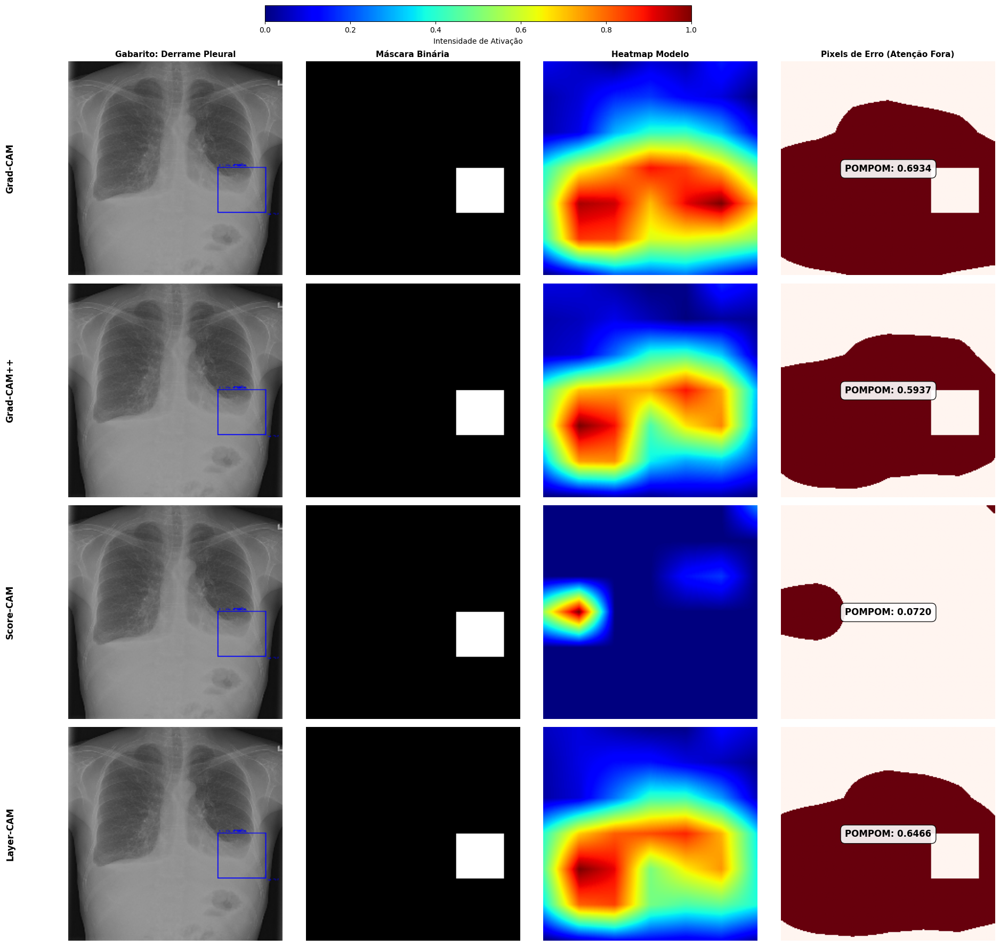


--- Gerando POMPOM para: Massa Pulmonar ---


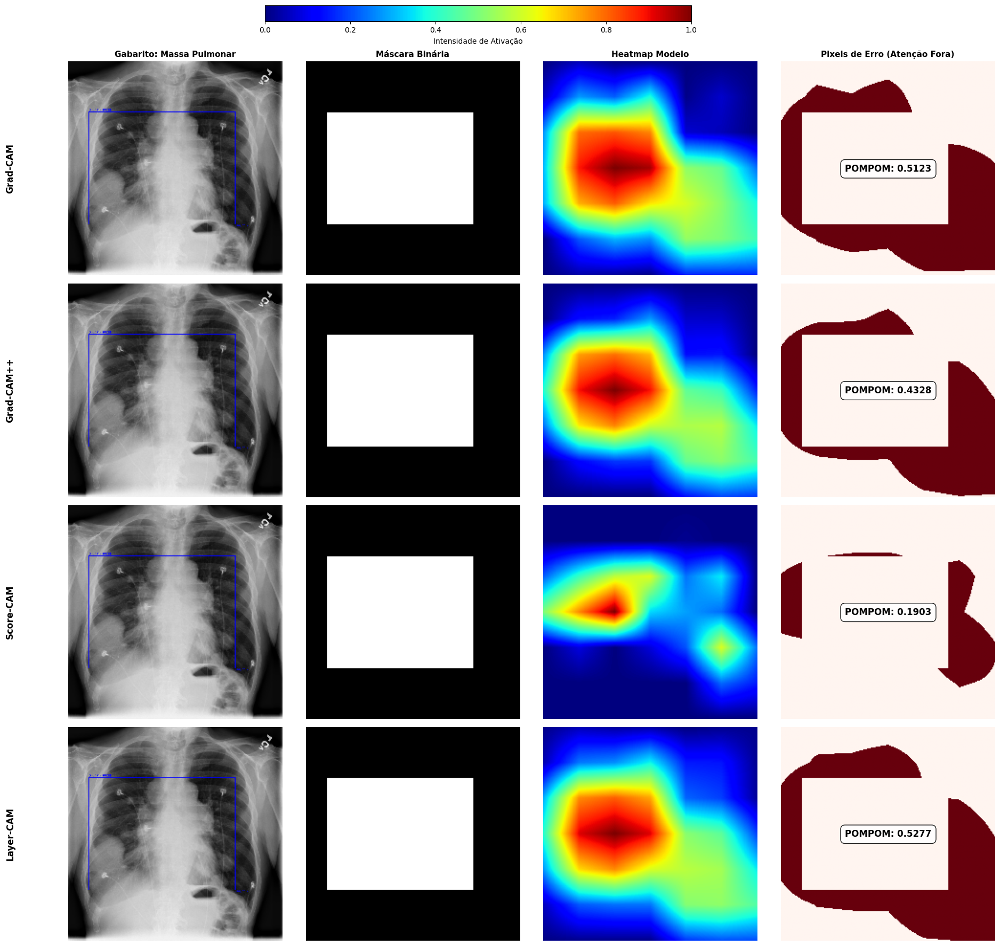


--- Gerando POMPOM para: Pneumotórax ---


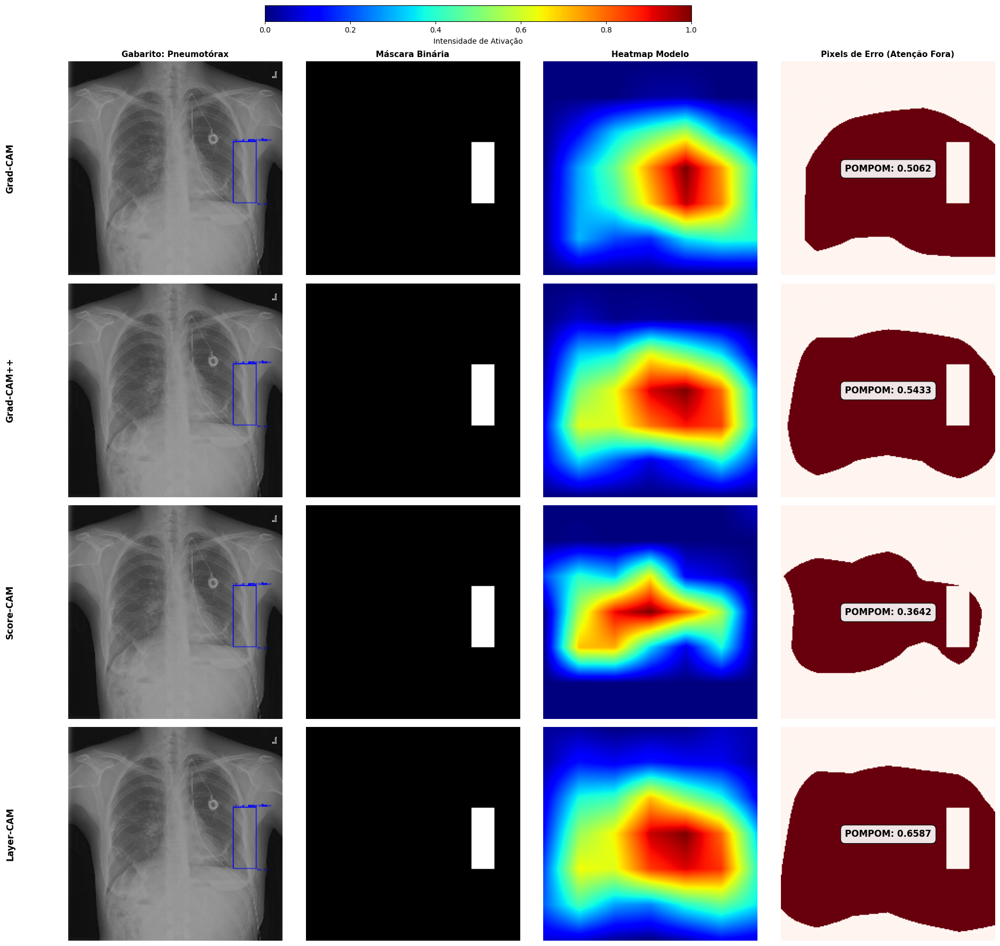


Análise POMPOM concluída.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import cv2
import os

epsilon = 0.2  
target_size = (224, 224)

BBOX_DIR = "./images_with_bboxes"

traducao = {
    'Effusion': 'Derrame Pleural',
    'Mass': 'Massa Pulmonar',
    'Pneumothorax': 'Pneumotórax',
    'Atelectasis': 'Atelectasia',
    'Infiltration': 'Infiltração',
    'Nodule': 'Nódulo'
}

norm = plt.Normalize(vmin=0, vmax=1)
sm = cm.ScalarMappable(cmap='jet', norm=norm)
sm.set_array([])


num_images = len(selected_image_indices)
method_names = list(all_generated_heatmaps.keys())

for j in range(num_images):
    
    filename = selected_image_indices[j]
    title_en = image_titles[j]
    title_pt = traducao.get(title_en, title_en)
    
    full_path = os.path.join(TEST_DIR, filename)
    img_high_res = cv2.imread(full_path)
    if img_high_res is None: continue
    h_orig, w_orig = img_high_res.shape[:2]


    base_name = os.path.splitext(filename)[0]
    bbox_filename = f"{base_name}_{title_en.lower()}_bbox.png" 
    bbox_path = os.path.join(BBOX_DIR, bbox_filename)
    
    if os.path.exists(bbox_path):
        img_bbox_vis = cv2.imread(bbox_path)
        img_bbox_vis = cv2.cvtColor(img_bbox_vis, cv2.COLOR_BGR2RGB)
        img_bbox_vis = cv2.resize(img_bbox_vis, target_size)
    else:
        print(f"Aviso: Imagem BBox não encontrada em {bbox_path}. Usando original.")
        img_bbox_vis = cv2.resize(cv2.cvtColor(img_high_res, cv2.COLOR_BGR2RGB), target_size)

    row = bbox_df[bbox_df['Image Index'] == filename]
    if row.empty: continue
    
    data = row.iloc[0]
    bbox_original = [data['Bbox [x'], data['y'], data['w'], data['h]']]
    
    mask_high = np.zeros((h_orig, w_orig), dtype=np.float32)
    x, y, w, h = [int(v) for v in bbox_original]
    mask_high[y:y+h, x:x+w] = 1.0
    gt_mask = cv2.resize(mask_high, target_size, interpolation=cv2.INTER_NEAREST)

    print(f"\n--- Gerando POMPOM para: {title_pt} ---")

    num_methods = len(method_names)
    fig, axes = plt.subplots(nrows=num_methods, ncols=4, figsize=(20, num_methods * 5))
    if num_methods == 1: axes = np.expand_dims(axes, axis=0)

    for i, (method_name, heatmaps) in enumerate(all_generated_heatmaps.items()):
        
        heatmap_data = heatmaps[j].copy()
        if heatmap_data.max() > heatmap_data.min():
            heatmap_norm = (heatmap_data - heatmap_data.min()) / (heatmap_data.max() - heatmap_data.min())
        else:
            heatmap_norm = heatmap_data

        inverted_mask = 1.0 - gt_mask
        explanation_in_background = heatmap_norm * inverted_mask
        meaningful_pixels_outside = np.sum(explanation_in_background > epsilon)
        total_background_pixels = np.sum(inverted_mask) + 1e-6
        pompom_score = meaningful_pixels_outside / total_background_pixels


        ax_vis = axes[i, 0]
        if i == 0: 
            ax_vis.set_title(f"Gabarito: {title_pt}", fontsize=11, fontweight='bold')
        
        ax_vis.text(-0.25, 0.5, method_name, transform=ax_vis.transAxes,
                     rotation=90, va='center', ha='right', fontsize=12, fontweight='bold')
        
        ax_vis.imshow(img_bbox_vis)
        ax_vis.axis('off')

        ax_mask = axes[i, 1]
        if i == 0: ax_mask.set_title("Máscara Binária", fontsize=11, fontweight='bold')
        ax_mask.imshow(gt_mask, cmap='gray')
        ax_mask.axis('off')

        ax_heat = axes[i, 2]
        if i == 0: ax_heat.set_title("Heatmap Modelo", fontsize=11, fontweight='bold')
        ax_heat.imshow(heatmap_norm, cmap='jet', vmin=0, vmax=1)
        ax_heat.axis('off')

        ax_err = axes[i, 3]
        error_vis = np.zeros_like(heatmap_norm)
        error_vis[explanation_in_background > epsilon] = 1 # Pixels errados
        
        ax_err.imshow(error_vis, cmap='Reds', vmin=0, vmax=1)

        color_res = "#000000"
        
        if i == 0: 
            ax_err.set_title("Pixels de Erro (Atenção Fora)", fontsize=11, fontweight='bold')
            
        text_str = f"POMPOM: {pompom_score:.4f}"
        ax_err.text(target_size[0]/2, target_size[1]/2, text_str,
                      ha='center', va='center', fontsize=12, fontweight='bold',
                      bbox=dict(facecolor='white', alpha=0.9, edgecolor=color_res, boxstyle='round,pad=0.5'))
        ax_err.axis('off')

    plt.tight_layout(rect=[0.05, 0.03, 1, 0.88]) 
    
    cbar_ax = fig.add_axes([0.30, 0.90, 0.40, 0.015]) 
    cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Intensidade de Ativação', fontsize=10, labelpad=5)

    plt.show()

print("\nAnálise POMPOM concluída.")